# Import libraries

In [1]:
import os
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.cm as cm

import seaborn as sns

from numpy.polynomial.polynomial import Polynomial

from scipy.signal import savgol_filter

from sklearn.preprocessing import MinMaxScaler

In [2]:
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', 50)

In [3]:
path_to_save = './../results/01b_visualization'

# Loading data

In [4]:
path_to_data= './../data/parsed_data'

## FTIR-spectra

In [5]:
initial_data = pd.read_csv(f'{path_to_data}/ftir_raw_spectra.csv', sep=';', index_col=0)

initial_data.columns = initial_data.columns.astype(float)

print(initial_data.shape)
initial_data.head(3)

(61, 3733)


,3998.31069,3997.34631,3996.38194,3995.41756,3994.45318,3993.48880,3992.52442,3991.56005,3990.59567,3989.63129,3988.66691,3987.70253,3986.73816,3985.77378,3984.80940,3983.84502,3982.88065,3981.91627,3980.95189,3979.98751,3979.02313,3978.05876,3977.09438,3976.13000,3975.16562,...,422.39751,421.43313,420.46876,419.50438,418.54000,417.57562,416.61124,415.64687,414.68249,413.71811,412.75373,411.78935,410.82498,409.86060,408.89622,407.93184,406.96747,406.00309,405.03871,404.07433,403.10995,402.14558,401.18120,400.21682,399.25244
division_1_size_bulk,-0.008580,-0.008580,-0.008580,-0.008580,-0.008580,-0.008580,-0.008580,-0.008612,-0.008578,-0.008559,-0.008554,-0.008587,-0.008574,-0.008486,-0.008457,-0.008504,-0.008556,-0.008586,-0.008602,-0.008547,-0.008460,-0.008443,-0.008471,-0.008505,-0.008509,...,0.005667,0.005664,0.005700,0.005717,0.005726,0.005732,0.005741,0.005662,0.005531,0.005438,0.005388,0.005372,0.005361,0.005383,0.005366,0.005290,0.005246,0.005210,0.005174,0.005174,0.005174,0.005174,0.005174,0.005174,0.005174
division_1_size_5,-0.008005,-0.008005,-0.008005,-0.008005,-0.008005,-0.008005,-0.008005,-0.008121,-0.008191,-0.008250,-0.008269,-0.008278,-0.008247,-0.008157,-0.008120,-0.008136,-0.008145,-0.008111,-0.008079,-0.008044,-0.007976,-0.007943,-0.007927,-0.007923,-0.007929,...,0.010026,0.010000,0.009974,0.009935,0.009883,0.009873,0.009853,0.009706,0.009551,0.009473,0.009416,0.009341,0.009259,0.009198,0.009123,0.009064,0.009072,0.009097,0.009078,0.009078,0.009078,0.009078,0.009078,0.009078,0.009078
division_1_size_3,-0.003743,-0.003743,-0.003743,-0.003743,-0.003743,-0.003743,-0.003743,-0.003775,-0.003766,-0.003757,-0.003773,-0.003883,-0.003973,-0.003965,-0.003945,-0.003949,-0.003970,-0.003917,-0.003853,-0.003797,-0.003700,-0.003678,-0.003729,-0.003794,-0.003794,...,0.005184,0.005200,0.005233,0.005221,0.005201,0.005209,0.005200,0.005069,0.004923,0.004889,0.004884,0.004844,0.004761,0.004684,0.004632,0.004606,0.004621,0.004636,0.004621,0.004621,0.004621,0.004621,0.004621,0.004621,0.004621


## Samples description

In [6]:
samples_description = pd.read_csv(f'{path_to_data}/samples_description.csv', sep=';', index_col=0)

print(samples_description.shape)
samples_description.head(3)

(61, 4)


,Division,Size,Fraction_hue,Fraction_grouped_hue
division_1_size_bulk,1,bulk,$> 0$,$d > 5$
division_1_size_5,1,5,$< 5$,$2 < d \leq 5$
division_1_size_3,1,3,$< 3$,$2 < d \leq 5$


# Data preprocessing

## Waverange selection

In [7]:
initial_data = initial_data.loc[:, (initial_data.columns >= 650) & (initial_data.columns <= 4000)]

## Baseline correction

In [8]:
data = initial_data.copy()

for idx in data.index:
    coefs = Polynomial.fit(data.columns, data.loc[idx], deg=2).convert().coef
    baseline = np.polyval(coefs[::-1], data.columns)
    
    corrected_intensity = data.loc[idx] - baseline
    corrected_intensity -= corrected_intensity.min()
    
    data.loc[idx] = corrected_intensity

print(data.shape)
data.head(3)

(61, 3472)


,3998.31069,3997.34631,3996.38194,3995.41756,3994.45318,3993.48880,3992.52442,3991.56005,3990.59567,3989.63129,3988.66691,3987.70253,3986.73816,3985.77378,3984.80940,3983.84502,3982.88065,3981.91627,3980.95189,3979.98751,3979.02313,3978.05876,3977.09438,3976.13000,3975.16562,...,674.10014,673.13576,672.17138,671.20700,670.24263,669.27825,668.31387,667.34949,666.38512,665.42074,664.45636,663.49198,662.52760,661.56323,660.59885,659.63447,658.67009,657.70571,656.74134,655.77696,654.81258,653.84820,652.88382,651.91945,650.95507
division_1_size_bulk,0.000139,0.000134,0.000129,0.000124,0.000119,0.000113,0.000108,0.000071,0.000099,0.000113,0.000113,0.000075,0.000082,0.000165,0.000190,0.000137,0.000080,0.000045,0.000023,0.000073,0.000155,0.000167,0.000134,0.000095,0.000085,...,0.002544,0.002648,0.002820,0.002960,0.003084,0.003195,0.003241,0.003200,0.003133,0.003067,0.002971,0.002885,0.002836,0.002845,0.002865,0.002856,0.002848,0.002833,0.002826,0.002825,0.002836,0.002878,0.002930,0.002981,0.003009
division_1_size_5,0.000307,0.000304,0.000301,0.000298,0.000295,0.000292,0.000288,0.000169,0.000096,0.000034,0.000012,0.000000,0.000027,0.000115,0.000148,0.000129,0.000117,0.000148,0.000177,0.000209,0.000273,0.000304,0.000316,0.000317,0.000308,...,0.004738,0.004787,0.004970,0.005174,0.005319,0.005407,0.005456,0.005491,0.005502,0.005437,0.005303,0.005143,0.005013,0.005004,0.005080,0.005164,0.005242,0.005301,0.005376,0.005467,0.005505,0.005472,0.005409,0.005344,0.005260
division_1_size_3,0.000300,0.000296,0.000292,0.000288,0.000284,0.000281,0.000277,0.000241,0.000246,0.000251,0.000231,0.000118,0.000024,0.000028,0.000044,0.000037,0.000011,0.000061,0.000121,0.000173,0.000267,0.000285,0.000230,0.000161,0.000157,...,0.002075,0.002107,0.002263,0.002425,0.002559,0.002640,0.002667,0.002671,0.002643,0.002559,0.002423,0.002263,0.002148,0.002171,0.002239,0.002267,0.002291,0.002300,0.002318,0.002362,0.002396,0.002421,0.002446,0.002475,0.002496


## Smoothing (*Savitzky–Golay*)

In [9]:
data_smoothed = data.copy()

for idx in data_smoothed.index:
    data_smoothed.loc[idx] = savgol_filter(data_smoothed.loc[idx], window_length=127, polyorder=3)

print(data_smoothed.shape)
data_smoothed.head(3)

(61, 3472)


,3998.31069,3997.34631,3996.38194,3995.41756,3994.45318,3993.48880,3992.52442,3991.56005,3990.59567,3989.63129,3988.66691,3987.70253,3986.73816,3985.77378,3984.80940,3983.84502,3982.88065,3981.91627,3980.95189,3979.98751,3979.02313,3978.05876,3977.09438,3976.13000,3975.16562,...,674.10014,673.13576,672.17138,671.20700,670.24263,669.27825,668.31387,667.34949,666.38512,665.42074,664.45636,663.49198,662.52760,661.56323,660.59885,659.63447,658.67009,657.70571,656.74134,655.77696,654.81258,653.84820,652.88382,651.91945,650.95507
division_1_size_bulk,0.000172,0.000166,0.000159,0.000153,0.000148,0.000142,0.000137,0.000133,0.000128,0.000124,0.000120,0.000117,0.000114,0.000111,0.000108,0.000106,0.000104,0.000102,0.000100,0.000099,0.000098,0.000097,0.000097,0.000096,0.000096,...,0.002810,0.002816,0.002822,0.002828,0.002834,0.002840,0.002845,0.002851,0.002856,0.002861,0.002866,0.002871,0.002876,0.002880,0.002885,0.002889,0.002893,0.002896,0.002900,0.002904,0.002907,0.002910,0.002913,0.002915,0.002918
division_1_size_5,0.000232,0.000231,0.000230,0.000229,0.000228,0.000228,0.000228,0.000228,0.000228,0.000228,0.000229,0.000230,0.000231,0.000232,0.000234,0.000235,0.000237,0.000239,0.000241,0.000244,0.000246,0.000249,0.000252,0.000255,0.000258,...,0.005104,0.005114,0.005123,0.005132,0.005142,0.005151,0.005160,0.005170,0.005179,0.005188,0.005197,0.005206,0.005215,0.005224,0.005233,0.005241,0.005250,0.005259,0.005268,0.005276,0.005285,0.005293,0.005302,0.005310,0.005319
division_1_size_3,0.000343,0.000328,0.000314,0.000300,0.000287,0.000274,0.000262,0.000250,0.000239,0.000229,0.000219,0.000209,0.000200,0.000192,0.000184,0.000176,0.000169,0.000162,0.000156,0.000150,0.000145,0.000140,0.000135,0.000131,0.000127,...,0.002231,0.002239,0.002247,0.002255,0.002264,0.002272,0.002281,0.002290,0.002299,0.002309,0.002318,0.002328,0.002338,0.002348,0.002359,0.002369,0.002380,0.002391,0.002402,0.002414,0.002426,0.002438,0.002450,0.002462,0.002475


## Wavenumber range selection & scaling to range [0...1] (*MinMax*)

### Main data sets

*Five intervals were selected as the main ones for further analysis: 3800-2400, 2400-2200, 1800-1500, 1500-1300, 1300-900.*

In [10]:
ranges = [
    (3800, 2200),
    (1900, 800),
    (3800, 2400),
    (2400, 2200),
    (1800, 1500),
    (1500, 1300),
    (1300, 900)
]

data_smoothed_ranges = {}
data_scaled_ranges = {}

In [11]:
for range in ranges:
    high_boundary, low_boundary = range

    # Wavenumber range selection
    data_smoothed_ranges[range] = data_smoothed.loc[:, (data_smoothed.columns <= high_boundary) & (data_smoothed.columns >= low_boundary)]

    # Data scaling
    scaler = MinMaxScaler()

    data_scaled = data_smoothed_ranges[range].copy()
    data_scaled.iloc[:, :] = scaler.fit_transform(data_scaled.T).T
    data_scaled_ranges[range] = data_scaled

    # Main data sets statistics
    print(
        f'-' * 224,
        f'WAVENUMBER RANGE: {range}',
        f'(*) Smoothed data set shape: {data_smoothed_ranges[range].shape}',
        f'(*) Scaled data set shape: {data_scaled_ranges[range].shape}',
        f'(*) Wavenumber for smoothed data (max/min): {round(data_smoothed_ranges[range].columns.max()), round(data_smoothed_ranges[range].columns.min())}',
        f'(*) Wavenumber for scaled data (max/min): {round(data_smoothed_ranges[range].columns.max()), round(data_smoothed_ranges[range].columns.min())}',
        sep='\n'
    )
    # display(data_smoothed_ranges[range].head(3))

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WAVENUMBER RANGE: (3800, 2200)
(*) Smoothed data set shape: (61, 1659)
(*) Scaled data set shape: (61, 1659)
(*) Wavenumber for smoothed data (max/min): (3800, 2201)
(*) Wavenumber for scaled data (max/min): (3800, 2201)
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WAVENUMBER RANGE: (1900, 800)
(*) Smoothed data set shape: (61, 1141)
(*) Scaled data set shape: (61, 1141)
(*) Wavenumber for smoothed data (max/min): (1900, 800)
(*) Wavenumber for scaled data (max/min): (1900, 800)
---------------------------------------------------------------------------------------------------------------

# Data visualization

## Base variables

In [12]:
divisions_lst = sorted(samples_description['Division'].unique())
print(divisions_lst)

[1, 2, 5, 6, 7, 8, 9, 10]


In [13]:
X_LABEL_FONT_SIZE = 14
Y_LABEL_FONT_SIZE = 14

X_TICK_FONT_SIZE = 12
Y_TICK_FONT_SIZE = 12

LEGEND_TITLE_FONT_SIZE = 12
LEGEND_FONT_SIZE = 12

TITLE_FONT_SIZE = 16

In [14]:
sns.set_theme()

## Base functions

### Spectra plotting

In [15]:
def plot_spectra(data_vis, ax, samples_description=None, hue_column=None, style_params=None, plot_params=None, legend_params=None):
    if style_params is None:
        style_params = {
            "X_LABEL_FONT_SIZE": 14,
            "Y_LABEL_FONT_SIZE": 14,
            "X_TICK_FONT_SIZE": 12,
            "Y_TICK_FONT_SIZE": 12,
            "TITLE_FONT_SIZE": 16,
        }
    
    if plot_params is None:
        plot_params = {
            "X_LABEL": 'Волновое число, см$^{-1}$',
            "Y_LABEL": '$A$',
            "TITLE": '',
            "Y_LABELPAD": 5,
            "X_LABELPAD": 5,
            "X_NBINS": 12,
            "Y_NBINS": 12,
            "X_STEP": None,
            "Y_STEP": None,
            "LINEWIDTH": 2.5,
            "ALPHA": 0.8,
            "COLORMAP": 'bwr'
        }

    if legend_params is None:
        legend_params = {
            "TITLE": 'Тип размерной фракции, мкм',
            "LOC": 'best',
            "NCOL": 3,
            "FONTSIZE": 12,
            "TITLE_FONTSIZE": 14
        }

    if samples_description is not None and hue_column is not None:
        hue_values = samples_description.loc[data_vis.index, hue_column].astype(str)
        unique_hue_values = hue_values.unique()
        colors = cm.get_cmap(plot_params["COLORMAP"])(np.linspace(0.2, 1.0, len(unique_hue_values)))
        color_map = dict(zip(unique_hue_values, colors))

        plot_data = [(fraction, hue_values[fraction], color_map[hue_values[fraction]]) for fraction in data_vis.index]
    else:
        fractions_sorted = sorted(
            data_vis.index,
            key=lambda x: float(x.split('_')[-1].replace('bulk', '1000')),
            reverse=True
        )
        colors = cm.get_cmap(plot_params["COLORMAP"])(np.linspace(0.2, 1.0, len(fractions_sorted)))
        labels = [f'$> 0$' if frac.split('_')[-1] == 'bulk' else f'$< {frac.split("_")[-1]}$' for frac in fractions_sorted]
        plot_data = zip(fractions_sorted, labels, colors)

    seen_labels = set()
    for fraction, label, color in plot_data:
        legend_label = label if label not in seen_labels else None
        seen_labels.add(label)

        ax.plot(
            data_vis.columns,
            data_vis.loc[fraction],
            label=legend_label,
            alpha=plot_params["ALPHA"],
            color=color,
            linewidth=plot_params["LINEWIDTH"]
        )

    ax.set_title(plot_params["TITLE"], fontsize=style_params["TITLE_FONT_SIZE"], fontstyle='italic')
    
    ax.set_xlabel(plot_params['X_LABEL'], fontsize=style_params["X_LABEL_FONT_SIZE"], labelpad=plot_params["X_LABELPAD"])
    ax.set_ylabel(plot_params['Y_LABEL'], fontsize=style_params["Y_LABEL_FONT_SIZE"], labelpad=plot_params["Y_LABELPAD"], rotation=0)
    
    ax.tick_params(axis='x', labelsize=style_params["X_TICK_FONT_SIZE"])
    ax.tick_params(axis='y', labelsize=style_params["Y_TICK_FONT_SIZE"])

    if plot_params["X_STEP"] is None:
        ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=plot_params["X_NBINS"]))
    else:
        ax.xaxis.set_major_locator(ticker.MultipleLocator(plot_params["X_STEP"]))
    
    if plot_params["Y_STEP"] is None:
        ax.yaxis.set_major_locator(ticker.MaxNLocator(nbins=plot_params["Y_NBINS"]))
    else:
        ax.yaxis.set_major_locator(ticker.MultipleLocator(plot_params["Y_STEP"]))

    ax.invert_xaxis()

    ax.legend(
        title=legend_params["TITLE"],
        loc=legend_params["LOC"],
        ncol=legend_params["NCOL"],
        title_fontsize=legend_params["TITLE_FONTSIZE"],
        fontsize=legend_params["FONTSIZE"]
    )

### Creating annotation

In [16]:
def add_annotation(ax, text, xy=(0.013, 0.98), fontsize=12, facecolor='white', edgecolor='black', alpha=0.5):
    ax.annotate(
        text=text,
        xy=xy,
        xycoords='axes fraction',
        fontsize=fontsize,
        fontweight='bold',
        color='black',
        ha='left',
        va='top',
        bbox={
            'facecolor': facecolor,
            'edgecolor': edgecolor,
            'boxstyle': 'round',
            'alpha': alpha
        }
    )

## FTIR-spectra (*raw & baseline correted & smoothed*) in region 4000-400 cm$^{-1}$ (`ar`)

### All size fractional divisions

*Config-features for visualization*

In [17]:
custom_plot_params = {
    "X_LABEL": 'Волновое число, см$^{-1}$',
    "Y_LABEL": '$A$',
    "TITLE": '',
    "Y_LABELPAD": 15,
    "X_LABELPAD": 5,
    "X_NBINS": 10,
    "Y_NBINS": 10,
    "X_STEP": None,
    "Y_STEP": None,
    "LINEWIDTH": 3.5,
    "ALPHA": 0.9,
    "COLORMAP": 'bwr'  # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    "Y_LABEL_FONT_SIZE": 16,
    "X_LABEL_FONT_SIZE": 16,
    "X_TICK_FONT_SIZE": 14,
    "Y_TICK_FONT_SIZE": 14,
    "TITLE_FONT_SIZE": 18,
}

# Кастомные параметры легенды
custom_legend = {
    "TITLE": 'Размерная фракция, мкм',
    "LOC": 'upper right',
    "NCOL": 1,
    "FONTSIZE": 14,
    "TITLE_FONTSIZE": 16
}

*Spectra visualization*

In [18]:
nrows = len(divisions_lst)
ncols = 3

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 5), dpi=300)

for i, division in enumerate(divisions_lst):
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Selecting parts of data by index
    initial_data_vis = initial_data.loc[idx_lst]
    data_vis = data.loc[idx_lst]
    data_smoothed_vis = data_smoothed.loc[idx_lst]

    # Visualization
    for j, tmp_data in enumerate([initial_data_vis, data_vis, data_smoothed_vis]):

        if i > 0:
            custom_plot_params["TITLE"] = ''
        else:
            custom_plot_params["TITLE"] = 'Исходные ИК-спектры' if j == 0 else 'Коррекция базовой линии' if j == 1 else 'Сглаживание фильтром $СГ$'
        
        plot_spectra(
            data_vis=tmp_data,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

    # Creating annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}' + f' = {division}$',
        xy=(0.013, 0.98),
        fontsize=TITLE_FONT_SIZE - 4
    )
    

plt.tight_layout()

# plt.savefig(f'{path_to_save}/all_raw_bc_smoothed_spectra.png', dpi=600)

plt.show()

### Only fractional division №9

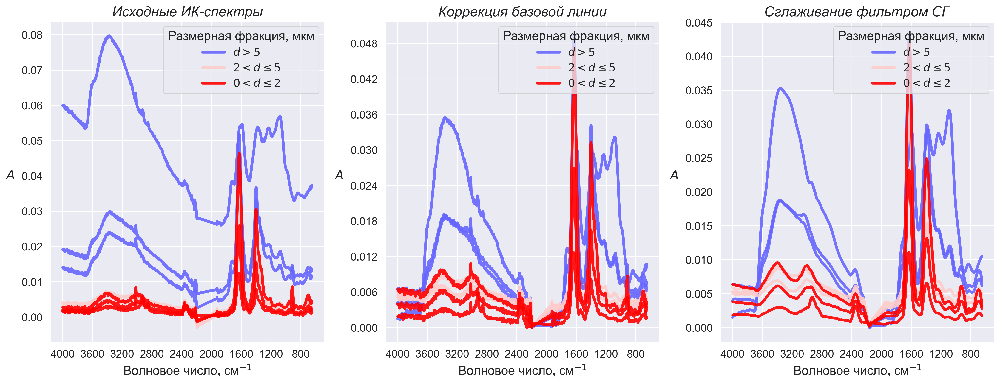

In [19]:
nrows = 1
ncols = 3

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 7), dpi=300)

for i, division in enumerate([9]):
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Selecting parts of data by index
    initial_data_vis = initial_data.loc[idx_lst]
    data_vis = data.loc[idx_lst]
    data_smoothed_vis = data_smoothed.loc[idx_lst]

    # Visualization
    for j, tmp_data in enumerate([initial_data_vis, data_vis, data_smoothed_vis]):

        custom_plot_params["TITLE"] = 'Исходные ИК-спектры' if j == 0 else 'Коррекция базовой линии' if j == 1 else 'Сглаживание фильтром $СГ$'
        
        plot_spectra(
            data_vis=tmp_data,
            ax=axes[j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

plt.tight_layout()

plt.savefig(f'{path_to_save}/raw_bc_smoothed_spectra_all_range_div_9.png', dpi=600)

plt.show()

## Smoothed FTIR-spectra in selected wavenumber regions

*Config-features for visualization*

In [20]:
custom_plot_params = {
    "X_LABEL": 'Волновое число, см$^{-1}$',
    "Y_LABEL": '$A$',
    "TITLE": '',
    "Y_LABELPAD": 15,
    "X_LABELPAD": 5,
    "X_NBINS": 10,
    "Y_NBINS": 10,
    "X_STEP": None,
    "Y_STEP": None,
    "LINEWIDTH": 4.0,
    "ALPHA": 0.9,
    "COLORMAP": 'bwr'  # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    "Y_LABEL_FONT_SIZE": 18,
    "X_LABEL_FONT_SIZE": 18,
    "X_TICK_FONT_SIZE": 16,
    "Y_TICK_FONT_SIZE": 16,
    "TITLE_FONT_SIZE": 18,
}

# Кастомные параметры легенды
custom_legend = {
    "TITLE": 'Размерная фракция, мкм',
    "LOC": 'upper right',
    "NCOL": 1,
    "FONTSIZE": 14,
    "TITLE_FONTSIZE": 16
}

*Spectra visualization*

In [21]:
nrows = len(divisions_lst)
ncols = 7

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6.5, nrows * 5), dpi=300)

for i, division in enumerate(divisions_lst):
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Visualization
    for j, (wn_range, tmp_data) in enumerate(data_smoothed_ranges.items()):

        tmp_data_vis = tmp_data.loc[idx_lst]

        if i > 0:
            custom_plot_params["TITLE"] = ''
        else:
            custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$' + ' $см^{-1}$'
        
        plot_spectra(
            data_vis=tmp_data_vis,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

    # Creating annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}' + f' = {division}$',
        xy=(0.013, 0.98),
        fontsize=TITLE_FONT_SIZE - 4
    )
    

plt.tight_layout()

# plt.savefig(f'{path_to_save}/all_smoothed_spectra_by_wn_regions_and_divisions.png', dpi=600)

plt.show()

## Scaled FTIR-spectra

### `2` splitted wavenumber regions (*wide*)

*Config-features for visualization*

In [22]:
custom_plot_params = {
    "X_LABEL": 'Волновое число, см$^{-1}$',
    "Y_LABEL": '$A_{n}$',
    "TITLE": '',
    "Y_LABELPAD": 15,
    "X_LABELPAD": 5,
    "X_NBINS": 10,
    "Y_NBINS": 12,
    "X_STEP": None,
    "Y_STEP": None,
    "LINEWIDTH": 4.0,
    "ALPHA": 0.9,
    "COLORMAP": 'bwr'  # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    "Y_LABEL_FONT_SIZE": 18,
    "X_LABEL_FONT_SIZE": 18,
    "X_TICK_FONT_SIZE": 16,
    "Y_TICK_FONT_SIZE": 16,
    "TITLE_FONT_SIZE": 18,
}

# Кастомные параметры легенды
custom_legend = {
    "TITLE": 'Размерная фракция, мкм',
    "LOC": 'upper right',
    "NCOL": 1,
    "FONTSIZE": 14,
    "TITLE_FONTSIZE": 16
}

*Spectra visualization*

In [23]:
ranges_lst = [
    (3800, 2200),
    (1900, 800)
]

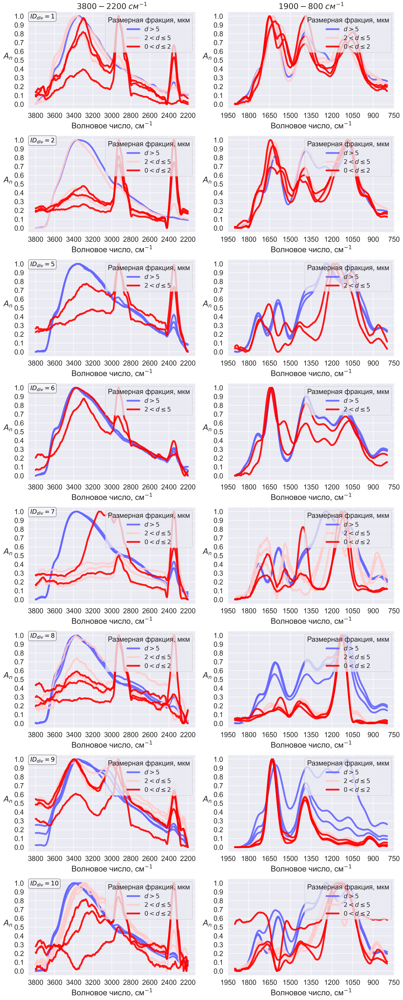

In [24]:
nrows = len(divisions_lst)
ncols = 2

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6.5, nrows * 4), dpi=300)

for i, division in enumerate(divisions_lst):
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Visualization
    for j, wn_range in enumerate(ranges_lst):

        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        if i > 0:
            custom_plot_params["TITLE"] = ''
        else:
            custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$' + ' $см^{-1}$'
        
        plot_spectra(
            data_vis=tmp_data_vis,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

    # Creating annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}' + f' = {division}$',
        xy=(0.013, 0.98),
        fontsize=TITLE_FONT_SIZE - 2
    )
    

plt.tight_layout()

# plt.savefig(f'{path_to_save}/all_scaled_spectra_by_2_wn_regions_and_divisions.png', dpi=600)

plt.show()

### `5` splitted wavenumber regions (*tight*)

*Config-features for visualization*

In [25]:
custom_plot_params = {
    "X_LABEL": 'Волновое число, см$^{-1}$',
    "Y_LABEL": '$A_{n}$',
    "TITLE": '',
    "Y_LABELPAD": 15,
    "X_LABELPAD": 5,
    "X_NBINS": 10,
    "Y_NBINS": 12,
    "X_STEP": None,
    "Y_STEP": None,
    "LINEWIDTH": 4.0,
    "ALPHA": 0.9,
    "COLORMAP": 'bwr'  # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    "Y_LABEL_FONT_SIZE": 18,
    "X_LABEL_FONT_SIZE": 18,
    "X_TICK_FONT_SIZE": 16,
    "Y_TICK_FONT_SIZE": 16,
    "TITLE_FONT_SIZE": 18,
}

# Кастомные параметры легенды
custom_legend = {
    "TITLE": 'Размерная фракция, мкм',
    "LOC": 'upper right',
    "NCOL": 1,
    "FONTSIZE": 14,
    "TITLE_FONTSIZE": 16
}

*Spectra visualization*

In [26]:
ranges_lst = [
    (3800, 2400),
    (2400, 2200),
    (1800, 1500),
    (1500, 1300),
    (1300, 900)
]

In [27]:
nrows = len(divisions_lst)
ncols = 5

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6.5, nrows * 5), dpi=300)

for i, division in enumerate(divisions_lst):
    # Selecting index for current division
    idx_lst = samples_description.loc[samples_description['Division'] == division].index

    # Visualization
    for j, wn_range in enumerate(ranges_lst):

        tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

        if i > 0:
            custom_plot_params["TITLE"] = ''
        else:
            custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$' + ' $см^{-1}$'
        
        plot_spectra(
            data_vis=tmp_data_vis,
            ax=axes[i][j],
            samples_description=samples_description,
            hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
            plot_params=custom_plot_params,
            style_params=custom_style,
            legend_params=custom_legend
        )

    # Creating annotation
    add_annotation(
        ax=axes[i, 0],
        text='$ID_{div}' + f' = {division}$',
        xy=(0.013, 0.98),
        fontsize=TITLE_FONT_SIZE - 4
    )
    

plt.tight_layout()

# plt.savefig(f'{path_to_save}/all_scaled_spectra_by_5_wn_regions_and_divisions.png', dpi=600)

plt.show()

### Additional analysis of *division №9* (3800-2200, 1900-800 cm$^{-1}$)

*Config-features for visualization*

In [28]:
custom_plot_params = {
    "X_LABEL": 'Волновое число, см$^{-1}$',
    "Y_LABEL": '$A_{n}$',
    "TITLE": '',
    "Y_LABELPAD": 15,
    "X_LABELPAD": 5,
    "X_NBINS": 15,
    "Y_NBINS": 12,
    "X_STEP": None,
    "Y_STEP": None,
    "LINEWIDTH": 4.0,
    "ALPHA": 0.9,
    "COLORMAP": 'bwr'  # bwr, viridis, twilight, inferno, coolwarm
}

custom_style = {
    "Y_LABEL_FONT_SIZE": 18,
    "X_LABEL_FONT_SIZE": 18,
    "X_TICK_FONT_SIZE": 16,
    "Y_TICK_FONT_SIZE": 16,
    "TITLE_FONT_SIZE": 18,
}

# Кастомные параметры легенды
custom_legend = {
    "TITLE": 'Размерная фракция, мкм',
    "LOC": 'upper right',
    "NCOL": 2,
    "FONTSIZE": 14,
    "TITLE_FONTSIZE": 16
}

*Spectra visualization*

In [29]:
ranges_lst = [
    (3800, 2200),
    (1900, 800)
]

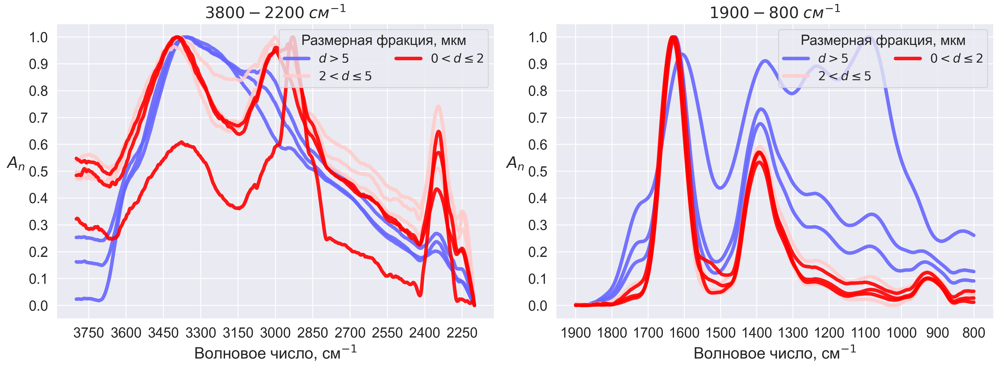

In [30]:
nrows = 1
ncols = 2

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 6), dpi=300)

idx_lst = samples_description.loc[samples_description['Division'] == 9].index

for j, wn_range in enumerate(ranges_lst):

    tmp_data_vis = data_scaled_ranges[wn_range].loc[idx_lst]

    custom_plot_params["TITLE"] = f'${wn_range[0]}-{wn_range[1]}$' + ' $см^{-1}$'
    
    plot_spectra(
        data_vis=tmp_data_vis,
        ax=axes[j],
        samples_description=samples_description,
        hue_column='Fraction_grouped_hue',  # Fraction_hue, Fraction_grouped_hue
        plot_params=custom_plot_params,
        style_params=custom_style,
        legend_params=custom_legend
    )

plt.tight_layout()

# plt.savefig(f'{path_to_save}/scaled_spectra_hwr_fpr_div_9.png', dpi=600)

plt.show()

# Saving data

In [31]:
path_to_save_data = './../data/preprocessed_data'

## Smoothed data & smoothed data by regions

In [32]:
data_smoothed.to_csv(f'{path_to_save_data}/smoothed_data/ftir_smoothed_4000_650.csv', sep=';')

for range, tmp_data in data_smoothed_ranges.items():
    tmp_data.to_csv(f'{path_to_save_data}/smoothed_data/ftir_smoothed_{range[0]}_{range[1]}.csv', sep=';')

## Scaled data by region

In [33]:
for range, tmp_data in data_scaled_ranges.items():
    tmp_data.to_csv(f'{path_to_save_data}/scaled_data/ftir_scaled_{range[0]}_{range[1]}.csv', sep=';')